# Natural Languange Processing to find CpG Island presence in Promoter Sequences

### 0. Loading the Data

In [62]:
import os
from subprocess import PIPE, run
import time
import pandas as pd
import numpy as np 
import pprint
import requests

pp = pprint.PrettyPrinter()


Data = pd.read_csv('/Users/sergiomares/Desktop/Nunez/Jin file/TSS_CpG_crispriphenotype_table.txt', delimiter = '\t',header = 0)

b = []

for i in range (1000):
    datas = requests.get('http://togows.org/api/ucsc/hg19/'+ str(Data['chromosome'][i])+':'+str(int(Data["Primary TSS, 5'"][i]-1000))+'-'+str(Data["Primary TSS, 5'"][i]+1000)).text.replace('\n','')    
    b.append(datas)


### 1. Data Pre-processing and model k-mer generation

In [85]:
Promoter_sequences = pd.DataFrame(b)

# Get all permutations of [1, 2, 3]
# perm = ['A','C','G','T']
# nucleotides = []

# for p in range(1):
#     for i in list(perm):
#             for x in range(10):
#                 temp = '%s%s' % (x, i)
#                 nucleotides.append(temp)
#     for z in range(len(Promoter_sequences)):
#             for h in list(nucleotides):
#                 Promoter_sequences[0][z] = Promoter_sequences[0][z].replace(h,str((h[0],h[1])))
#             if z % 1000 == 0:
#                 print(z)

# Promoter_sequences[0] = Promoter_sequences[0].str.replace("'", "").str.replace(" ", "").str.replace("(", "").str.replace(")", "").str.replace(">hg19:", "")
# Promoter_sequences = Promoter_sequences[0].str.split(",", expand = True)

Here you can select the length of the kmers used in the model

In [86]:
def getKmers(sequence, size=6):
    return [sequence[x:x+size].lower() for x in range(len(sequence) - size + 1)]

Promoter_sequences = Promoter_sequences.apply(lambda x: getKmers(x[0], 5), axis = 1)
Promoter_sequences = pd.DataFrame(Promoter_sequences)


The Scikit-learn library natural language processing tools do the k-mer counting. Here we convert the list into strings, which then get vectorized. The y variable will hold the class labels.

In [123]:
Promoters_text = list(Promoter_sequences[0][1])

for item in range(len(Promoter_sequences)):
    Promoters_text[item] = ' '.join(Promoter_sequences[0][item])

y_data = Promoter_sequences.iloc[:, 0].values     


This is the Bag-of-words technique for natural language processing of text modelling.

In [125]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer()
#cv = CountVectorizer(ngram_range=(3,100))
X = cv.fit_transform(Promoters_text)

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y_data, test_size = 0.20, random_state=42)

print(X.shape)

ValueError: Found input variables with inconsistent numbers of samples: [1997, 1000]

Here we graph the correspondent data of each of the Promoter sequences

<AxesSubplot:>

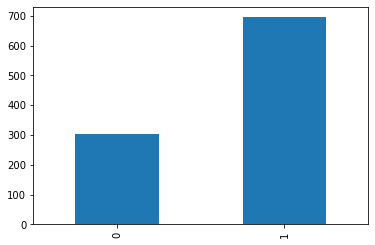

In [7]:
Promoter_sequences[3].value_counts().sort_index().plot.bar()

### 2. Multinomial Naive Bayes Model 

Here, the multinomal naive bayes classifier is used. More information at https://scikit-learn.org/stable/modules/generated/sklearn.naive_bayes.MultinomialNB.html

In [13]:
from sklearn.naive_bayes import MultinomialNB
classifier = MultinomialNB(alpha=0.1)
classifier.fit(X_train, y_train)

MultinomialNB(alpha=0.1)

Prediction:

In [9]:
y_pred = classifier.predict(X_test)

Confusion Matrix: 

In [10]:
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
print("Confusion matrix\n")
print(pd.crosstab(pd.Series(y_test, name='Actual'), pd.Series(y_pred, name='Predicted')))
def get_metrics(y_test, y_predicted):
    accuracy = accuracy_score(y_test, y_predicted)
    precision = precision_score(y_test, y_predicted, average='weighted')
    recall = recall_score(y_test, y_predicted, average='weighted')
    f1 = f1_score(y_test, y_predicted, average='weighted')
    return accuracy, precision, recall, f1
accuracy, precision, recall, f1 = get_metrics(y_test, y_pred)
print("accuracy = %.3f \nprecision = %.3f \nrecall = %.3f \nf1 = %.3f" % (accuracy, precision, recall, f1))

Confusion matrix

Predicted   0    1
Actual            
0          48    9
1          16  127
accuracy = 0.875 
precision = 0.881 
recall = 0.875 
f1 = 0.877


We can also graph the score for each of the combinations of letter, and compare significance.

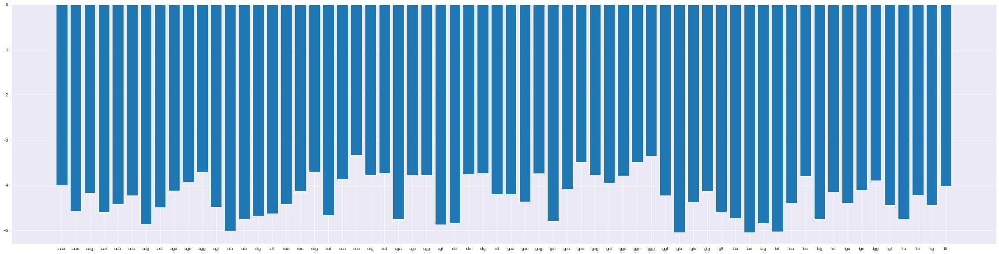

In [187]:
import matplotlib.pyplot as plt

weights = pd.DataFrame([cv.get_feature_names(), classifier.coef_[0]]).T
weights.sort_values(by = 1)

plt.rcParams["figure.figsize"] = (40,10)
plt.bar(weights[0],weights[1])
plt.show()

### 3. Genism word2vec Model Training

Genism, a Natural Language Processing Library for the Word2Vec algorithm

Adapted from https://towardsdatascience.com/a-beginners-guide-to-word-embedding-with-gensim-word2vec-model-5970fa56cc92

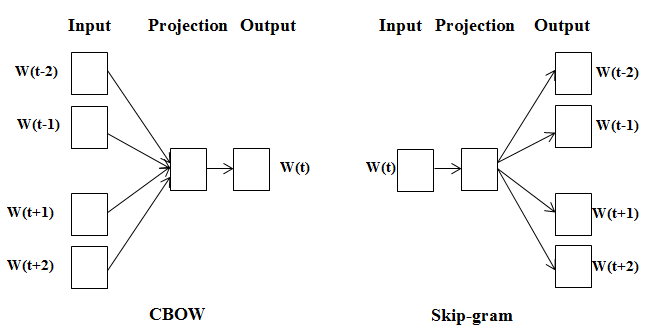

In [76]:
from IPython.display import Image
Image("https://i.stack.imgur.com/ShJJX.png")

In [77]:
import gensim
from gensim.utils import simple_preprocess
Promoters_text = pd.DataFrame(Promoters_text, columns=['seq'])
Review_text = Promoters_text.seq.apply(simple_preprocess)

from gensim.models import Word2Vec

vector_size_ = len(Promoters_text)

model = Word2Vec(vector_size = vector_size_, sg = 0)
#model = Word2Vec(sg = 0)
model.build_vocab(Review_text, progress_per=3)
model.train(Review_text, total_examples=model.corpus_count, epochs = model.epochs)

(9929743, 9985000)

In [78]:
from gensim.models import KeyedVectors

word_vectors = model.wv
word_vectors.save("word2vec.wordvectors")
wv = KeyedVectors.load("word2vec.wordvectors", mmap='r')

**size:** The number of dimensions of the embeddings and the default is 100.

**window:** The maximum distance between a target word and words around the target word. The default window is 5.

**min_count:** The minimum count of words to consider when training the model; words with occurrence less than this count will be ignored. The default for min_count is 5.

**workers:** The number of partitions during training and the default workers is 3.

**sg:** The training algorithm, either CBOW(0) or skip gram(1). The default training algorithm is CBOW.

After training the word2vec model, we can obtain the word embedding directly from the training model as following.

### 4. Compute Similarities

In [133]:
model.wv.most_similar('gcgcg')
#model.wv.similarity(w1 = "ccc", w2 = 'aaa')

[('gcgct', 0.6381992101669312),
 ('gcgca', 0.6352564692497253),
 ('tcgcg', 0.5627754330635071),
 ('acgcg', 0.5485557913780212),
 ('ccgcg', 0.5271724462509155),
 ('gcgcc', 0.5113396644592285),
 ('agcgt', 0.30144038796424866),
 ('tgcgt', 0.2996762692928314),
 ('tgcga', 0.27547571063041687),
 ('gtgcg', 0.26360994577407837)]

However, Euclidian similarity cannot work well for the high-dimensional word vectors. This is because Euclidian similarity will increase as the number of dimensions increases, even if the word embedding stands for different meanings. Alternatively, we can use cosine similarity to measure the similarity between two vectors. Mathematically, it measures the cosine of the angle between two vectors projected in a multi-dimensional space. The cosine similarity captures the angle of the word vectors and not the magnitude. Under cosine similarity, no similarity is expressed as a 90-degree angle while the total similarity of 1 is at a 0-degree angle.

In [602]:
from numpy import dot
from numpy.linalg import norm

Promoter_sequences.columns = ['seq', 'cpgs']

def cosine_distance (model, word,target_list , num) :
    cosine_dict = {}
    word_list = []
    a = model[word]
    for item in target_list :
        if item != word :
            b = model [item]
            cos_sim = dot(a, b)/(norm(a)*norm(b))
            cosine_dict[item] = cos_sim
    dist_sort=sorted(cosine_dict.items(), key=lambda dist: dist[1],reverse = True) ## in Descedning order 
    for item in dist_sort:
        word_list.append((item[0], item[1]))
    return word_list[0:num]
    
cosine_distance (model.wv,'cgc', Promoter_sequences.seq[1], 10)

[('cgg', 0.73119956),
 ('ccc', 0.57004744),
 ('cga', 0.5594351),
 ('ggc', 0.54884386),
 ('cgt', 0.5104356),
 ('gcc', 0.46744898),
 ('ccg', 0.45250645),
 ('gcg', 0.33724627),
 ('agc', 0.31745133),
 ('tgc', 0.31684658)]

### 5. T-SNE Visualizations

It’s hard to visualize the word embedding directly, for they usually have more than 3 dimensions. T-SNE is a useful tool to visualize high-dimensional data by dimension reduction while keeping relative pairwise distance between points. It can be said that T-SNE looking for a new data representation where the neighborhood relations are preserved. The following code shows how to plot the word embedding with T-SNE plot.

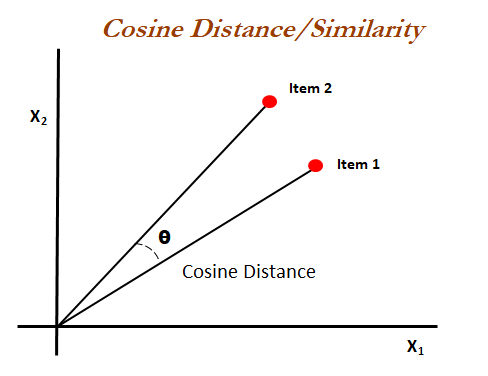

In [448]:
Image("https://www.oreilly.com/library/view/statistics-for-machine/9781788295758/assets/2b4a7a82-ad4c-4b2a-b808-e423a334de6f.png")

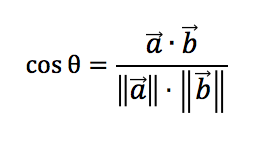

In [446]:
Image("https://sites.temple.edu/tudsc/files/2017/03/cosine-equation.png")

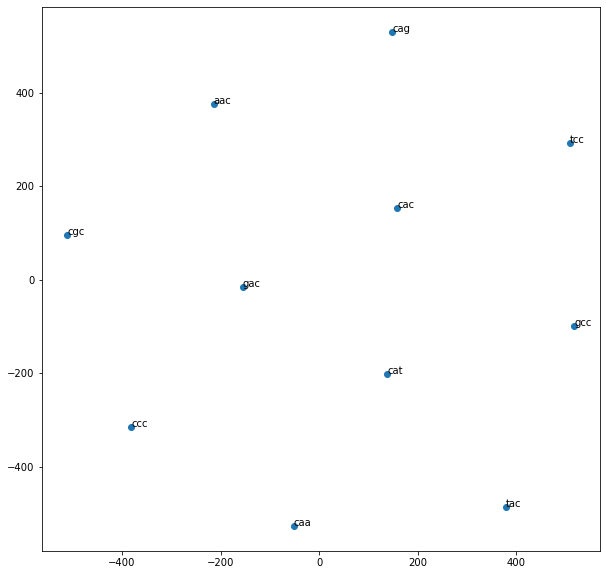

In [593]:
from sklearn.manifold import TSNE
from matplotlib import figure
from warnings import simplefilter

simplefilter(action='ignore', category=FutureWarning)

def display_closestwords_tsnescatterplot(model, word, size):
        
    arr = np.empty((0,size), dtype='f')
    word_labels = [word]

    close_words = model.similar_by_word(word)

    arr = np.append(arr, np.array([model[word]]), axis=0)

    for wrd_score in close_words:
        wrd_vector = model[wrd_score[0]]
        word_labels.append(wrd_score[0])
        arr = np.append(arr, np.array([wrd_vector]), axis=0)
            
        tsne = TSNE(n_components=2, random_state=0)
        np.set_printoptions(suppress=True)
        Y = tsne.fit_transform(arr)

    x_coords = Y[:, 0]
    y_coords = Y[:, 1]
    plt.scatter(x_coords, y_coords)

    for label, x, y in zip(word_labels, x_coords, y_coords):
        plt.annotate(label, xy=(x, y), xytext=(0, 0), textcoords='offset points')
            #plt.xlim(x_coords.min()+0.00005, x_coords.max()+0.00005)
            #plt.ylim(y_coords.min()+0.00005, y_coords.max()+0.00005)
    
    plt.rcParams["figure.figsize"] = (10,10)
    plt.show()

display_closestwords_tsnescatterplot(model.wv, 'cac', 7995) 

T-SNE plots generated with code adapted from https://www.kaggle.com/pierremegret/gensim-word2vec-tutorial

/Users/sergiomares/miniconda3/envs/tf/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/sergiomares/miniconda3/envs/tf/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


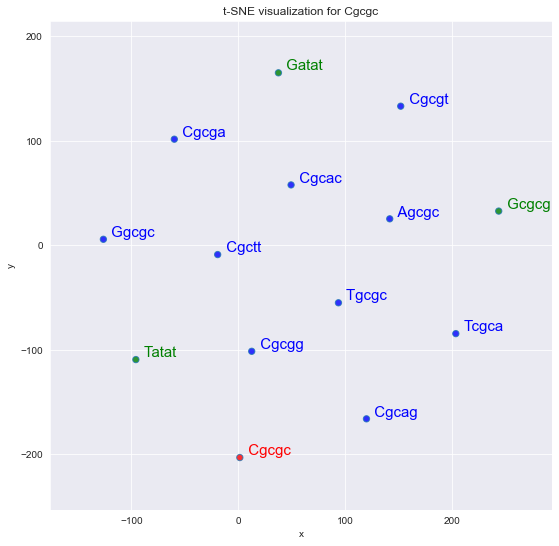

In [137]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
 
import seaborn as sns
sns.set_style("darkgrid")

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

def tsnescatterplot(model, word, list_names):
    """ Plot in seaborn the results from the t-SNE dimensionality reduction algorithm of the vectors of a query word,
    its list of most similar words, and a list of words.
    """
    arrays = np.empty((0, vector_size_), dtype='f')
    word_labels = [word]
    color_list  = ['red']

    # adds the vector of the query word
    arrays = np.append(arrays, model.wv.__getitem__([word]), axis=0)
    
    # gets list of most similar words
    close_words = model.wv.most_similar([word])
    
    # adds the vector for each of the closest words to the array
    for wrd_score in close_words:
        wrd_vector = model.wv.__getitem__([wrd_score[0]])
        word_labels.append(wrd_score[0])
        color_list.append('blue')
        arrays = np.append(arrays, wrd_vector, axis=0)
    
    # adds the vector for each of the words from list_names to the array
    for wrd in list_names:
        wrd_vector = model.wv.__getitem__([wrd])
        word_labels.append(wrd)
        color_list.append('green')
        arrays = np.append(arrays, wrd_vector, axis=0)
        
    # Reduces the dimensionality from 300 to 50 dimensions with PCA
    reduc = PCA(n_components=1).fit_transform(arrays)
    
    # Finds t-SNE coordinates for 2 dimensions
    np.set_printoptions(suppress=True)
    
    Y = TSNE(n_components=2, random_state=0, perplexity=15).fit_transform(reduc)
    
    # Sets everything up to plot
    df = pd.DataFrame({'x': [x for x in Y[:, 0]],
                       'y': [y for y in Y[:, 1]],
                       'words': word_labels,
                       'color': color_list})
    
    fig, _ = plt.subplots()
    fig.set_size_inches(9, 9)
    
    # Basic plot
    p1 = sns.regplot(data=df,
                     x="x",
                     y="y",
                     fit_reg=False,
                     marker="o",
                     scatter_kws={'s': 40,
                                  'facecolors': df['color']
                                 }
                    )
    
    # Adds annotations one by one with a loop
    for line in range(0, df.shape[0]):
         p1.text(df["x"][line],
                 df['y'][line],
                 '  ' + df["words"][line].title(),
                 horizontalalignment='left',
                 verticalalignment='bottom', size='medium',
                 color=df['color'][line],
                 weight='normal'
                ).set_size(15)

    
    plt.xlim(Y[:, 0].min()-50, Y[:, 0].max()+50)
    plt.ylim(Y[:, 1].min()-50, Y[:, 1].max()+50)
            
    plt.title('t-SNE visualization for {}'.format(word.title()))

tsnescatterplot(model, 'cgcgc', ['tatat','gatat','gcgcg'])

/Users/sergiomares/miniconda3/envs/tf/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/sergiomares/miniconda3/envs/tf/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


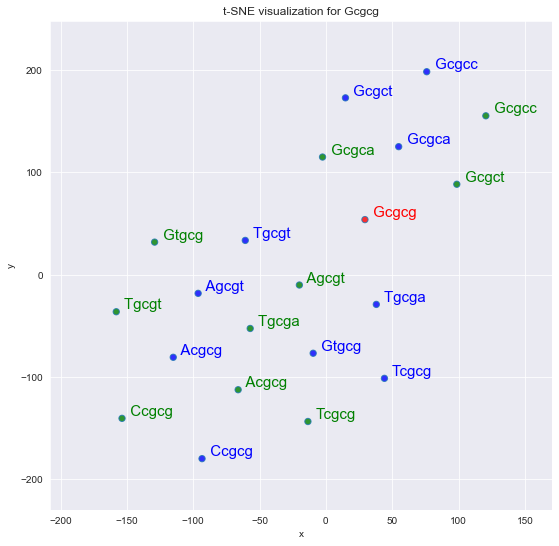

In [139]:
tsnescatterplot(model, 'gcgcg', [i[0] for i in model.wv.similar_by_word("gcgcg")])

/Users/sergiomares/miniconda3/envs/tf/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/sergiomares/miniconda3/envs/tf/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


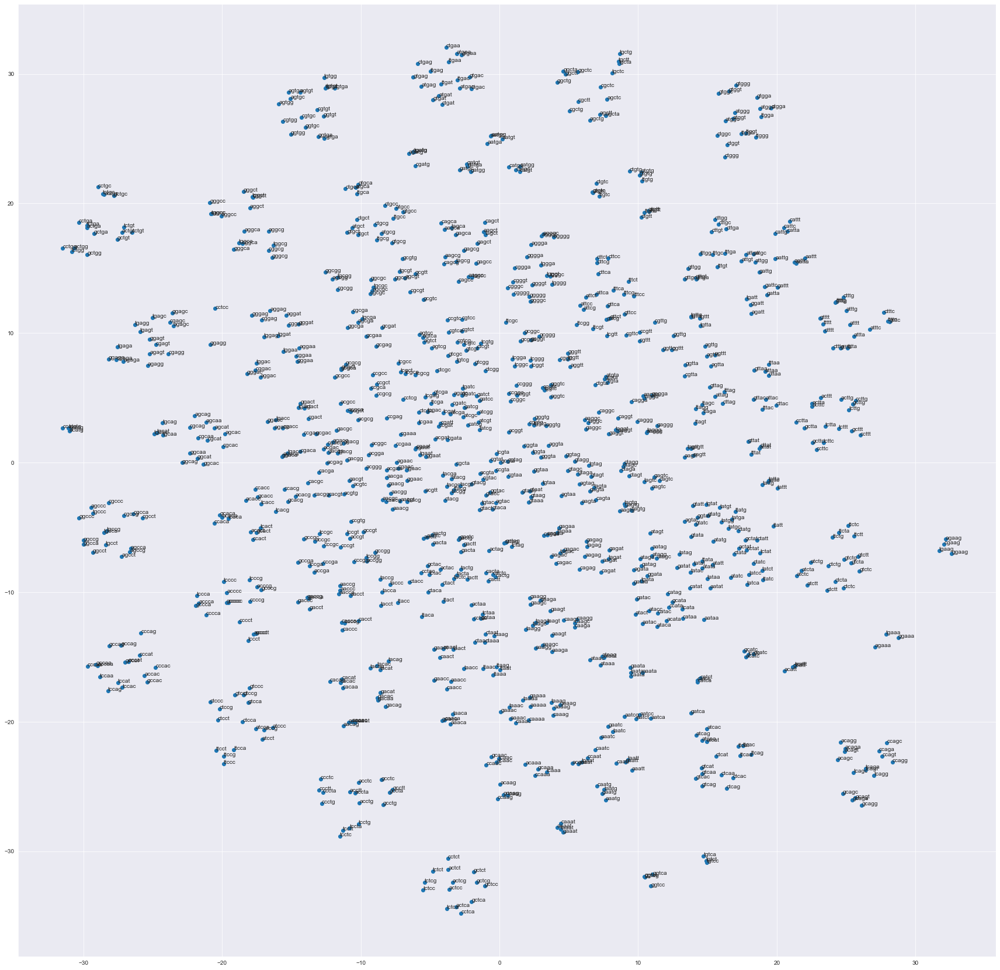

In [144]:
vocab = list(model.wv.key_to_index)
X = model.wv[vocab]
tsne = TSNE(n_components=2)
X_tsne = tsne.fit_transform(X)
df = pd.DataFrame(X_tsne, index=vocab, columns=['x', 'y'])
fig = plt.figure()
plt.rcParams["figure.figsize"] = (30,30)
ax = fig.add_subplot(1,1,1)
ax.scatter(df['x'], df['y'])

for word, pos in df.iterrows():
    plt.annotate(word, pos)

### 6. K-fold Cross-Validation in Keras Convolutional Neural Networks


Adapted from https://github.com/juanmangh/FrenchCandidateSpeechAnalysis/blob/master/Speech%20Analysis%20French%20Presidential%20Campaign%202017.ipynb

In [72]:
from keras.datasets import reuters
from keras.models import Sequential, Model
from keras import optimizers
from keras.layers import Dense, Dropout, Flatten, Reshape, Input, MaxPooling1D, Convolution1D, Embedding
from keras.utils import np_utils
from keras.layers.merge import Concatenate
from keras.preprocessing.text import Tokenizer
from keras.preprocessing import sequence

In [84]:
len(Promoter_sequences[2][0])

1997

In [105]:
conv_blocks = []
z = Embedding(1000, 12, input_length = 1997, name="embedding")(model_input)
z = Dropout(dropout_prob[0])(z)

In [109]:
from tensorflow import one_hot

# integer encode the documents
vocab_size = 1000
encoded_docs = [one_hot(d, vocab_size) for d in Promoter_sequences]

[<tf.Tensor: shape=(1000,), dtype=float32, numpy=
array([0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,

### 7. Word Window Classification

In [48]:
Processed_Promoters = Promoter_sequences[2]

train_labels = [[1 if word in Promoter_sequences[2] else 0 for word in sent] for sent in Processed_Promoters]
train_labels

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,


In [49]:
vocabulary = set(w for s in Processed_Promoters for w in s)
vocabulary

vocabulary.add("<unk>")

In [50]:
# Add the <pad> token to our vocabulary
vocabulary.add("<pad>")

# Function that pads the given sentence
# We are introducing this function here as an example
# We will be utilizing it later in the tutorial
def pad_window(sentence, window_size, pad_token="<pad>"):
  window = [pad_token] * window_size
  return window + sentence + window

# Show padding example
window_size = 2
pad_window(Processed_Promoters[0], window_size=window_size)

['<pad>',
 '<pad>',
 'tagcc',
 'agcca',
 'gccag',
 'ccaga',
 'cagac',
 'agacg',
 'gacgt',
 'acgtg',
 'cgtgg',
 'gtggc',
 'tggcg',
 'ggcga',
 'gcgat',
 'cgatg',
 'gatgc',
 'atgca',
 'tgcat',
 'gcatg',
 'catgc',
 'atgcc',
 'tgccc',
 'gccca',
 'cccag',
 'ccagg',
 'caggc',
 'aggct',
 'ggctc',
 'gctcc',
 'ctccc',
 'tccca',
 'cccag',
 'ccagc',
 'cagct',
 'agcta',
 'gctac',
 'ctact',
 'tactt',
 'acttg',
 'cttgg',
 'ttggg',
 'tggga',
 'gggag',
 'ggagg',
 'gaggc',
 'aggct',
 'ggctg',
 'gctga',
 'ctgag',
 'tgagg',
 'gaggc',
 'aggca',
 'ggcag',
 'gcagg',
 'cagga',
 'aggag',
 'ggagg',
 'gagga',
 'aggat',
 'ggatc',
 'gatcg',
 'atcgc',
 'tcgct',
 'cgctt',
 'gcttg',
 'cttga',
 'ttgag',
 'tgagc',
 'gagcc',
 'agcct',
 'gcctg',
 'cctgg',
 'ctggg',
 'tggga',
 'gggag',
 'ggagg',
 'gaggt',
 'aggtc',
 'ggtca',
 'gtcaa',
 'tcaaa',
 'caaaa',
 'aaaac',
 'aaact',
 'aactg',
 'actgc',
 'ctgca',
 'tgcag',
 'gcagt',
 'cagtg',
 'agtga',
 'gtgag',
 'tgagc',
 'gagcc',
 'agccg',
 'gccgg',
 'ccgga',
 'cggac',
 'ggact',


In [51]:
ix_to_word = sorted(list(vocabulary))

# Creating a dictionary to find the index of a given word
word_to_ix = {word: ind for ind, word in enumerate(ix_to_word)}

In [52]:
def convert_token_to_indices(sentence, word_to_ix):
  indices = []
  for token in sentence:
    # Check if the token is in our vocabularly. If it is, get it's index. 
    # If not, get the index for the unknown token.
    if token in word_to_ix:
      index = word_to_ix[token]
    else:
      index = word_to_ix["<unk>"]
    indices.append(index)
  return indices

# More compact version of the same function
def _convert_token_to_indices(sentence, word_to_ix):
  return [word_to_ind.get(token, word_to_ix["<unk>"]) for token in sentence]

# Show an example
example_sentence = ["atttt", "gcgcc", "gcgcg", "tatat", "tagca"]
example_indices = convert_token_to_indices(example_sentence, word_to_ix)
restored_example = [ix_to_word[ind] for ind in example_indices]

print(f"Original sentence is: {example_sentence}")
print(f"Going from words to indices: {example_indices}")
print(f"Going from indices to words: {restored_example}")


Original sentence is: ['atttt', 'gcgcc', 'gcgcg', 'tatat', 'tagca']
Going from words to indices: [257, 615, 616, 821, 806]
Going from indices to words: ['atttt', 'gcgcc', 'gcgcg', 'tatat', 'tagca']


In [53]:
example_padded_indices = [convert_token_to_indices(s, word_to_ix) for s in Processed_Promoters]

[[807,
  150,
  596,
  330,
  291,
  136,
  541,
  112,
  444,
  747,
  936,
  666,
  613,
  400,
  571,
  230,
  917,
  592,
  315,
  231,
  919,
  598,
  340,
  332,
  299,
  169,
  671,
  631,
  471,
  854,
  340,
  331,
  297,
  158,
  627,
  457,
  801,
  128,
  508,
  1004,
  938,
  676,
  652,
  555,
  169,
  672,
  634,
  484,
  908,
  555,
  166,
  660,
  588,
  298,
  164,
  652,
  554,
  165,
  655,
  568,
  219,
  873,
  417,
  640,
  506,
  996,
  907,
  551,
  153,
  608,
  380,
  492,
  938,
  676,
  652,
  557,
  175,
  694,
  722,
  834,
  258,
  3,
  9,
  32,
  123,
  486,
  916,
  589,
  304,
  186,
  740,
  907,
  551,
  152,
  604,
  362,
  419,
  649,
  544,
  123,
  486,
  914,
  579,
  262,
  19,
  73,
  288,
  123,
  486,
  915,
  585,
  287,
  119,
  470,
  852,
  331,
  295,
  153,
  608,
  380,
  492,
  941,
  688,
  698,
  739,
  902,
  532,
  77,
  304,
  189,
  752,
  954,
  740,
  906,
  547,
  135,
  535,
  89,
  352,
  381,
  495,
  953,
  735,
  886,


In [54]:
import torch.nn as nn

embedding_dim = 5
embeds = nn.Embedding(len(vocabulary), embedding_dim)

# Printing the parameters in our embedding table
list(embeds.parameters())

[Parameter containing:
 tensor([[-0.7053,  0.0668, -0.0623, -0.0029, -0.3457],
         [ 0.5996,  0.5233, -0.9479,  2.4193, -0.4288],
         [ 0.2354, -0.2175,  0.8609, -1.8553,  0.1540],
         ...,
         [ 1.0199, -0.2254, -0.3294, -0.8619, -0.5675],
         [-1.1178,  0.0696, -0.1149, -0.1214, -0.6837],
         [-0.9594,  1.4721, -1.5074, -1.8307,  1.4696]], requires_grad=True)]

In [55]:
# Get the embedding for the word Paris
index = word_to_ix["tatat"]
index_tensor = torch.tensor(index, dtype=torch.long)
paris_embed = embeds(index_tensor)

tensor([ 2.1113, -0.6062, -0.0609, -0.0135, -0.6119],
       grad_fn=<EmbeddingBackward0>)

In [56]:
from torch.utils.data import DataLoader
from functools import partial

def custom_collate_fn(batch, window_size, word_to_ix):
  # Break our batch into the training examples (x) and labels (y)
  # We are turning our x and y into tensors because nn.utils.rnn.pad_sequence
  # method expects tensors. This is also useful since our model will be
  # expecting tensor inputs. 
  x, y = zip(*batch)

  # Now we need to window pad our training examples. We have already defined a 
  # function to handle window padding. We are including it here again so that
  # everything is in one place.
  def pad_window(sentence, window_size, pad_token="<pad>"):
    window = [pad_token] * window_size
    return window + sentence + window

  # Pad the train examples.
  x = [pad_window(s, window_size=window_size) for s in x]

  # Now we need to turn words in our training examples to indices. We are
  # copying the function defined earlier for the same reason as above.
  def convert_tokens_to_indices(sentence, word_to_ix):
    return [word_to_ix.get(token, word_to_ix["<unk>"]) for token in sentence]

  # Convert the train examples into indices.
  x = [convert_tokens_to_indices(s, word_to_ix) for s in x]

  # We will now pad the examples so that the lengths of all the example in 
  # one batch are the same, making it possible to do matrix operations. 
  # We set the batch_first parameter to True so that the returned matrix has 
  # the batch as the first dimension.
  pad_token_ix = word_to_ix["<pad>"]

  # pad_sequence function expects the input to be a tensor, so we turn x into one
  x = [torch.LongTensor(x_i) for x_i in x]
  x_padded = nn.utils.rnn.pad_sequence(x, batch_first=True, padding_value=pad_token_ix)

  # We will also pad the labels. Before doing so, we will record the number 
  # of labels so that we know how many words existed in each example. 
  lengths = [len(label) for label in y]
  lenghts = torch.LongTensor(lengths)

  y = [torch.LongTensor(y_i) for y_i in y]
  y_padded = nn.utils.rnn.pad_sequence(y, batch_first=True, padding_value=0)

  # We are now ready to return our variables. The order we return our variables
  # here will match the order we read them in our training loop.
  return x_padded, y_padded, lenghts  

In [57]:
def _custom_collate_fn(batch, window_size, word_to_ix):
  # Prepare the datapoints
  x, y = zip(*batch)  
  x = [pad_window(s, window_size=window_size) for s in x]
  x = [convert_tokens_to_indices(s, word_to_ix) for s in x]

  # Pad x so that all the examples in the batch have the same size
  pad_token_ix = word_to_ix["<pad>"]
  x = [torch.LongTensor(x_i) for x_i in x]
  x_padded = nn.utils.rnn.pad_sequence(x, batch_first=True, padding_value=pad_token_ix)

  # Pad y and record the length
  lengths = [len(label) for label in y]
  lenghts = torch.LongTensor(lengths)
  y = [torch.LongTensor(y_i) for y_i in y]
  y_padded = nn.utils.rnn.pad_sequence(y, batch_first=True, padding_value=0)

  return x_padded, y_padded, lenghts  

In [58]:
# Parameters to be passed to the DataLoader
data = list(zip(Processed_Promoters, train_labels))
batch_size = 2
shuffle = True
window_size = 2
collate_fn = partial(custom_collate_fn, window_size=window_size, word_to_ix=word_to_ix)

# Instantiate the DataLoader
loader = DataLoader(data, batch_size=batch_size, shuffle=shuffle, collate_fn=collate_fn)

# Go through one loop
counter = 0
for batched_x, batched_y, batched_lengths in loader:
  print(f"Iteration {counter}")
  print("Batched Input:")
  print(batched_x)
  print("Batched Labels:")
  print(batched_y)
  print("Batched Lengths:")
  print(batched_lengths)
  print("")
  counter += 1

Iteration 0
Batched Input:
tensor([[   0,    0, 1022,  ...,  490,    0,    0],
        [   0,    0,  944,  ...,  140,    0,    0]])
Batched Labels:
tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]])
Batched Lengths:
tensor([1997, 1997])

Iteration 1
Batched Input:
tensor([[  0,   0, 181,  ..., 966,   0,   0],
        [  0,   0, 492,  ..., 346,   0,   0]])
Batched Labels:
tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]])
Batched Lengths:
tensor([1997, 1997])

Iteration 2
Batched Input:
tensor([[  0,   0, 745,  ..., 921,   0,   0],
        [  0,   0,  17,  ..., 586,   0,   0]])
Batched Labels:
tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]])
Batched Lengths:
tensor([1997, 1997])

Iteration 3
Batched Input:
tensor([[  0,   0, 139,  ..., 617,   0,   0],
        [  0,   0, 129,  ..., 583,   0,   0]])
Batched Labels:
tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]])
Batched Lengths:
tensor([1997, 1997])

Iteration 4


In [59]:
# Print the original tensor
print(f"Original Tensor: ")
print(batched_x)
print("")

# Create the 2 * 2 + 1 chunks
chunk = batched_x.unfold(1, window_size*2 + 1, 1)
print(f"Windows: ")
print(chunk)

Original Tensor: 
tensor([[  0,   0, 263,  ..., 163,   0,   0],
        [  0,   0, 191,  ..., 159,   0,   0]])

Windows: 
tensor([[[   0,    0,  263,   22,   83],
         [   0,  263,   22,   83,  326],
         [ 263,   22,   83,  326,  276],
         ...,
         [ 182,  724,  844,  298,  163],
         [ 724,  844,  298,  163,    0],
         [ 844,  298,  163,    0,    0]],

        [[   0,    0,  191,  758,  980],
         [   0,  191,  758,  980,  842],
         [ 191,  758,  980,  842,  293],
         ...,
         [1022, 1012,  971,  809,  159],
         [1012,  971,  809,  159,    0],
         [ 971,  809,  159,    0,    0]]])


In [60]:
class WordWindowClassifier(nn.Module):

  def __init__(self, hyperparameters, vocab_size, pad_ix=0):
    super(WordWindowClassifier, self).__init__()
    
    """ Instance variables """
    self.window_size = hyperparameters["window_size"]
    self.embed_dim = hyperparameters["embed_dim"]
    self.hidden_dim = hyperparameters["hidden_dim"]
    self.freeze_embeddings = hyperparameters["freeze_embeddings"]

    """ Embedding Layer 
    Takes in a tensor containing embedding indices, and returns the 
    corresponding embeddings. The output is of dim 
    (number_of_indices * embedding_dim).

    If freeze_embeddings is True, set the embedding layer parameters to be
    non-trainable. This is useful if we only want the parameters other than the
    embeddings parameters to change. 

    """
    self.embeds = nn.Embedding(vocab_size, self.embed_dim, padding_idx=pad_ix)
    if self.freeze_embeddings:
      self.embed_layer.weight.requires_grad = False

    """ Hidden Layer
    """
    full_window_size = 2 * window_size + 1
    self.hidden_layer = nn.Sequential(
      nn.Linear(full_window_size * self.embed_dim, self.hidden_dim), 
      nn.Tanh()
    )

    """ Output Layer
    """
    self.output_layer = nn.Linear(self.hidden_dim, 1)

    """ Probabilities 
    """
    self.probabilities = nn.Sigmoid()

  def forward(self, inputs):
    """
    Let B:= batch_size
        L:= window-padded sentence length
        D:= self.embed_dim
        S:= self.window_size
        H:= self.hidden_dim
        
    inputs: a (B, L) tensor of token indices
    """
    B, L = inputs.size()

    """
    Reshaping.
    Takes in a (B, L) LongTensor
    Outputs a (B, L~, S) LongTensor
    """
    # Fist, get our word windows for each word in our input.
    token_windows = inputs.unfold(1, 2 * self.window_size + 1, 1)
    _, adjusted_length, _ = token_windows.size()

    # Good idea to do internal tensor-size sanity checks, at the least in comments!
    assert token_windows.size() == (B, adjusted_length, 2 * self.window_size + 1)

    """
    Embedding.
    Takes in a torch.LongTensor of size (B, L~, S) 
    Outputs a (B, L~, S, D) FloatTensor.
    """
    embedded_windows = self.embeds(token_windows)

    """
    Reshaping.
    Takes in a (B, L~, S, D) FloatTensor.
    Resizes it into a (B, L~, S*D) FloatTensor.
    -1 argument "infers" what the last dimension should be based on leftover axes.
    """
    embedded_windows = embedded_windows.view(B, adjusted_length, -1)

    """
    Layer 1.
    Takes in a (B, L~, S*D) FloatTensor.
    Resizes it into a (B, L~, H) FloatTensor
    """
    layer_1 = self.hidden_layer(embedded_windows)

    """
    Layer 2
    Takes in a (B, L~, H) FloatTensor.
    Resizes it into a (B, L~, 1) FloatTensor.
    """
    output = self.output_layer(layer_1)

    """
    Softmax.
    Takes in a (B, L~, 1) FloatTensor of unnormalized class scores.
    Outputs a (B, L~, 1) FloatTensor of (log-)normalized class scores.
    """
    output = self.probabilities(output)
    output = output.view(B, -1)

    return output

In [62]:
# Prepare the data
data = list(zip(Processed_Promoters, train_labels))
batch_size = 2
shuffle = True
window_size = 2
collate_fn = partial(custom_collate_fn, window_size=window_size, word_to_ix=word_to_ix)

# Instantiate a DataLoader
loader = DataLoader(data, batch_size=batch_size, shuffle=shuffle, collate_fn=collate_fn)

# Initialize a model
# It is useful to put all the model hyperparameters in a dictionary
model_hyperparameters = {
    "batch_size": 4,
    "window_size": 2,
    "embed_dim": 25,
    "hidden_dim": 25,
    "freeze_embeddings": False,
}

vocab_size = len(word_to_ix)
model = WordWindowClassifier(model_hyperparameters, vocab_size)

# Define an optimizer
learning_rate = 0.01
optimizer = torch.optim.SGD(model.parameters(), lr=learning_rate)

# Define a loss function, which computes to binary cross entropy loss
def loss_function(batch_outputs, batch_labels, batch_lengths):   
    # Calculate the loss for the whole batch
    bceloss = nn.BCELoss()
    loss = bceloss(batch_outputs, batch_labels.float())

    # Rescale the loss. Remember that we have used lengths to store the 
    # number of words in each training example
    loss = loss / batch_lengths.sum().float()

    return loss

In [63]:
# Function that will be called in every epoch
def train_epoch(loss_function, optimizer, model, loader):
  
  # Keep track of the total loss for the batch
  total_loss = 0
  for batch_inputs, batch_labels, batch_lengths in loader:
    # Clear the gradients
    optimizer.zero_grad()
    # Run a forward pass
    outputs = model.forward(batch_inputs)
    # Compute the batch loss
    loss = loss_function(outputs, batch_labels, batch_lengths)
    # Calculate the gradients
    loss.backward()
    # Update the parameteres
    optimizer.step()
    total_loss += loss.item()

  return total_loss


# Function containing our main training loop
def train(loss_function, optimizer, model, loader, num_epochs=10000):

  # Iterate through each epoch and call our train_epoch function
  for epoch in range(num_epochs):
    epoch_loss = train_epoch(loss_function, optimizer, model, loader)
    if epoch % 100 == 0: print(epoch_loss)

In [65]:
num_epochs = 10
train(loss_function, optimizer, model, loader, num_epochs=num_epochs)

0.09434779376897495


In [68]:
test_corpus = ["tatat gctat tatag cgcgc"]
test_sentences = [s.lower().split() for s in test_corpus]
test_labels = [[1, 1, 1, 1]]

# Create a test loader
test_data = list(zip(test_sentences, test_labels))
batch_size = 1
shuffle = False
window_size = 2
collate_fn = partial(custom_collate_fn, window_size=2, word_to_ix=word_to_ix)
test_loader = torch.utils.data.DataLoader(test_data, 
                                           batch_size=1, 
                                           shuffle=False, 
                                           collate_fn=collate_fn)

In [71]:
for test_instance, labels, _ in test_loader:
  outputs = model.forward(test_instance)
  print(labels)
  print(outputs)

tensor([[1, 1, 1, 1]])
tensor([[0.5116, 0.5723, 0.6185, 0.4728]], grad_fn=<ViewBackward0>)
